In [ ]:
# I referred the code for data pre-processsing from the following website
#url : https://medium.com/analytics-vidhya/cnn-lstm-architecture-and-image-captioning-2351fc18e8d7

In [ ]:
#bLOCK 1
#Install necessary libraries and package.
import string
import numpy as np
import pandas as pd
from numpy import array
from pickle import load
from PIL import Image
import pickle
from collections import Counter

import matplotlib.pyplot as plt
import keras
import sys, time, os, warnings
warnings.filterwarnings("ignore")
import re

import tensorflow as tf
from google.colab import drive
from nltk.translate.bleu_score import sentence_bleu
from nltk.tokenize import word_tokenize
from nltk.translate.meteor_score import meteor_score
from tqdm import tqdm
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras.utils import to_categorical
from keras.utils import plot_model
from keras.models import Model
from keras.layers import Input
from keras.layers import Dense, BatchNormalization
from keras.layers import LSTM
from keras.layers import Embedding
from keras.layers import Dropout
from tensorflow.keras.layers import add
import zipfile
from keras.callbacks import ModelCheckpoint
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.text import Tokenizer
from keras.applications.vgg16 import VGG16, preprocess_input
from PIL import UnidentifiedImageError
from sklearn.utils import shuffle
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle

In [ ]:
#BLOCK 2
! pip install nltk
import nltk

# Download the 'wordnet' resource
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [ ]:
#BLOCK 3
#mount google drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#BLOCK 4
#extract the flickr8k_Datset folder
with zipfile.ZipFile('/content/drive/MyDrive/CNN_LSTM/Flickr8k_Dataset (1).zip','r') as zipImage :
    zipImage.extractall('/content/drive/MyDrive/CNN_LSTM')

In [ ]:
#BLOCK 5
# Define paths
image_folder = '/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset'
features = {}

In [ ]:
# load vgg16 model
model = VGG16()
# restructure the model
model = Model(inputs=model.inputs, outputs=model.layers[-2].output)
# summarize
print(model.summary())

553467096/553467096 [==============================] - 8s 0us/step
Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                            

In [ ]:
#BLOCK 7
# Iterate over each image in the image folder
for img_name in tqdm(os.listdir(image_folder)):

    img_path = os.path.join(image_folder, img_name)


    try:
        # Open the image using PIL
        image = Image.open(img_path)

        # Resize the image to a specific size (e.g., 224x224)
        image = image.resize((224, 224))

        # Convert the image to a numpy array
        image = np.array(image)

        # Reshape the image array to match the expected input shape of the model
        image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))

        # Preprocess the image using the preprocess_input function specific to the model
        image = preprocess_input(image)

        # Extract features from the image using the pre-trained model
        feature = model.predict(image, verbose=0)

        # Extract the image ID (without extension) from the image name
        image_id = img_name.split('.')[0]

        # Store the extracted features in the dictionary
        features[image_id] = feature

    except FileNotFoundError:
        print(f"Skipping unidentified image file: {img_path}")


 12%|█▏        | 1002/8092 [03:40<07:41, 15.38it/s]

Skipping unidentified image file: /content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/features.pkl


100%|██████████| 8092/8092 [13:39<00:00,  9.87it/s]


In [ ]:
print(features)

{'380034515_4fbdfa6b26': array([[4.979054 , 2.9090369, 1.0698099, ..., 0.       , 1.736702 ,
        0.       ]], dtype=float32), '380041023_0dfd712ef1': array([[0., 0., 0., ..., 0., 0., 0.]], dtype=float32), '380515798_c2abbf46b0': array([[0.84188074, 0.        , 0.        , ..., 0.        , 2.8189573 ,
        0.        ]], dtype=float32), '380527679_574749123d': array([[0.      , 0.      , 0.      , ..., 0.      , 3.767988, 0.      ]],
      dtype=float32), '380537190_11d6c0a412': array([[0.       , 0.       , 0.       , ..., 1.2807992, 2.8260975,
        0.       ]], dtype=float32), '380590140_25b9889772': array([[0.       , 0.       , 0.       , ..., 0.       , 2.1343012,
        0.       ]], dtype=float32), '381052465_722e00807b': array([[0.       , 0.       , 3.9420466, ..., 5.852689 , 3.991727 ,
        0.       ]], dtype=float32), '381239475_044cbffa2b': array([[0.       , 0.       , 1.4354362, ..., 0.       , 1.4122531,
        0.       ]], dtype=float32), '381275595_b429fd16

In [ ]:
# Define the path to the file where the features will be saved
features_file_path = '/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/features.pkl'

# Open the file in binary write mode and serialize the 'features' dictionary
with open(features_file_path, 'wb') as f:
    pickle.dump(features, f)

In [ ]:
# Deserialize the object from the file

with open('/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/features.pkl', 'rb') as file:
    features = pickle.load(file)

print(features)

{'380034515_4fbdfa6b26': array([[4.979054 , 2.9090369, 1.0698099, ..., 0.       , 1.736702 ,
        0.       ]], dtype=float32), '380041023_0dfd712ef1': array([[0., 0., 0., ..., 0., 0., 0.]], dtype=float32), '380515798_c2abbf46b0': array([[0.84188074, 0.        , 0.        , ..., 0.        , 2.8189573 ,
        0.        ]], dtype=float32), '380527679_574749123d': array([[0.      , 0.      , 0.      , ..., 0.      , 3.767988, 0.      ]],
      dtype=float32), '380537190_11d6c0a412': array([[0.       , 0.       , 0.       , ..., 1.2807992, 2.8260975,
        0.       ]], dtype=float32), '380590140_25b9889772': array([[0.       , 0.       , 0.       , ..., 0.       , 2.1343012,
        0.       ]], dtype=float32), '381052465_722e00807b': array([[0.       , 0.       , 3.9420466, ..., 5.852689 , 3.991727 ,
        0.       ]], dtype=float32), '381239475_044cbffa2b': array([[0.       , 0.       , 1.4354362, ..., 0.       , 1.4122531,
        0.       ]], dtype=float32), '381275595_b429fd16

In [ ]:
# Define the path to the caption file
caption_file = '/content/drive/MyDrive/Image captioning/captions/Flickr8k.token.txt'

# Open the caption file in read mode and read its content
with open(caption_file, 'r') as f:
    # Skip the first line (header) of the file
    next(f)
    # Read the remaining content of the file
    captions_doc = f.read()

In [ ]:
# create mapping of image to captions
mapping = {}

# process lines
for line in tqdm(captions_doc.split('\n')):
    tokens = line.split('\t')
    if len(tokens) < 2:
        continue
    image_id, caption = tokens[0], tokens[1]
    # remove extension from image ID
    image_id = image_id.split('.')[0]
    # store the caption
    mapping[image_id] = caption


100%|██████████| 40460/40460 [00:00<00:00, 954817.03it/s]


In [ ]:
import re
import string

def clean(mapping):
    for key, captions in mapping.items():
        # Convert caption to a list if it's a string
        if isinstance(captions, str):
            mapping[key] = [captions]
        else:
            mapping[key] = captions

        # Preprocess each caption
        for i in range(len(mapping[key])):
            # Convert to lowercase
            caption = mapping[key][i].lower()

            # Remove punctuation and special characters
            caption = re.sub(r"[{}]".format(string.punctuation), "", caption)

            # Remove extra whitespaces
            caption = re.sub(r"\s+", " ", caption).strip()

            # Split the caption into words
            words = caption.split()

            # Remove words with fewer than 2 characters
            words = [word for word in words if len(word) > 1]

            # Join the words back into a caption
            caption = ' '.join(words)

            # Add "startseq" at the beginning and "endseq" at the end
            caption = 'startseq ' + caption + ' endseq'

            # Print the processed caption
            print("Processed Caption:", caption)



In [ ]:
print(clean(mapping))

Streaming output truncated to the last 5000 lines.
Processed Caption: startseq man dangling from rock as spectators watch endseq
Processed Caption: startseq the men in the gators helmets have their arms wrapped around each other endseq
Processed Caption: startseq man with hat taking photo with his camera while passerby looks annoyed endseq
Processed Caption: startseq lady holding umbrella over race car driver endseq
Processed Caption: startseq two people in field looking offcamera endseq
Processed Caption: startseq little boy in red walks in between branches in tree endseq
Processed Caption: startseq rollerblader grinding yellow road barrier endseq
Processed Caption: startseq dog digging for his ball in the sand endseq
Processed Caption: startseq some students sit outside school buildings in the grass endseq
Processed Caption: startseq the spotted dog rolls on its back endseq
Processed Caption: startseq child with swim goggles with face submerged halfway endseq
Processed Caption: start

In [ ]:
# Initialize an empty list to store all captions
all_captions = []

# Iterate over the keys in the 'mapping' dictionary (each key corresponds to an image)
for key in mapping:
    # Iterate over the captions associated with the current image
    for caption in mapping[key]:
        # Append the current caption to the 'all_captions' list
        all_captions.append(caption)


In [ ]:
# Create a tokenizer object and fit it on all captions to generate a vocabulary
tokenizer = Tokenizer()
tokenizer.fit_on_texts(all_captions)

# Calculate the vocabulary size, accounting for the special padding token
vocab_size = len(tokenizer.word_index) + 1


In [ ]:
# get maximum length of the caption available
max_length = max(len(caption.split()) for caption in all_captions)
max_length

38

In [ ]:
import pandas as pd
# Load the random_image_datset.csv file into a DataFrame
csv_file_path = '/content/drive/MyDrive/random_images_data (1).csv'
random_testimage_df = pd.read_csv(csv_file_path)

In [ ]:

# Extract all the image IDs from the DataFrame and use them as test data
test_image_ids = random_testimage_df['Image_ID'].tolist()

# Get all the image IDs from the 'mapping' dictionary
all_image_ids = list(mapping.keys())

# Calculate the indices for train and validation splits
train_split = 7237
val_split = 805

# Define the test data as the test_image_ids
test_data = test_image_ids

# Remove the test data from all_image_ids to get the remaining data for training and validation
train_val_data = list(set(all_image_ids) - set(test_data))

# Assign the remaining data to train_data and val_data based on the calculated splits
train_data = train_val_data[:train_split]
val_data = train_val_data[train_split:train_split + val_split]

# Print the number of test data, train data, and validation data
print(f"Number of Test Data: {len(test_data)}")
print(f"Number of Train Data: {len(train_data)}")
print(f"Number of Validation Data: {len(val_data)}")


Number of Test Data: 50
Number of Train Data: 7237
Number of Validation Data: 805


In [ ]:
def data_generator(data_keys, mapping, features, tokenizer, max_length, vocab_size, batch_size):
    X1, X2, y = [], [], []
    n = 0
    while True:
        for key in data_keys:
            if key not in features:
                continue  # Skip images without features
            captions = mapping[key]
            for caption in captions:
                seq = tokenizer.texts_to_sequences([caption])[0]
                for i in range(1, len(seq)):
                    in_seq, out_seq = seq[:i], seq[i]
                    in_seq = pad_sequences([in_seq], maxlen=max_length)[0]
                    out_seq = to_categorical([out_seq], num_classes=vocab_size)[0]
                    X1.append(features[key][0])
                    X2.append(in_seq)
                    y.append(out_seq)
                    n += 1
                    if n == batch_size:
                        X1, X2, y = np.array(X1), np.array(X2), np.array(y)
                        yield [X1, X2], y
                        X1, X2, y = [], [], []
                        n = 0


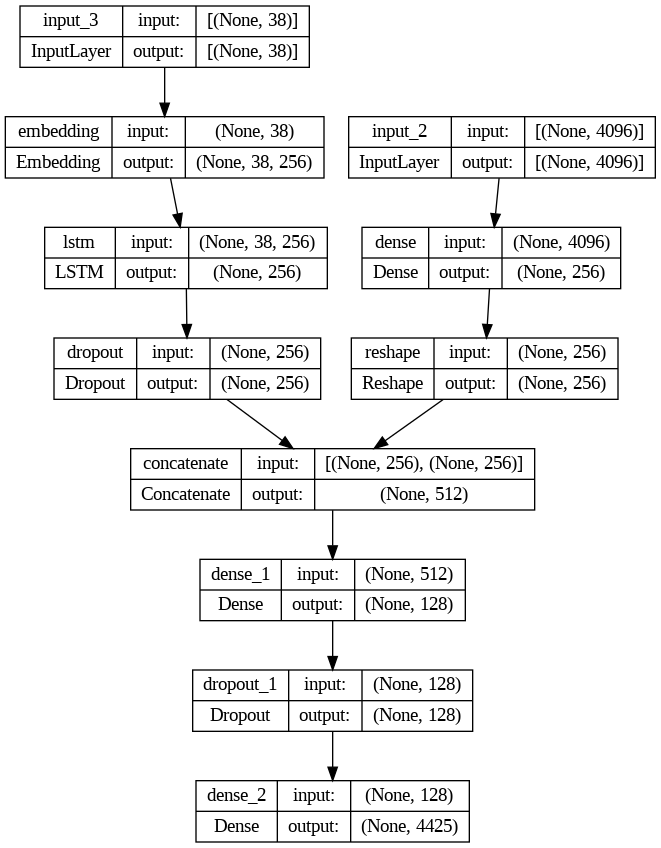

In [ ]:
from tensorflow.keras.layers import Input, Dense, Embedding, LSTM, Dropout, Reshape, concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.utils import plot_model

# encoder model
# image feature layers
inputs1 = Input(shape=(4096,))
fe2 = Dense(256, activation='relu')(inputs1)
img_features_reshaped = Reshape((256,), input_shape=(256,))(fe2)

# sequence feature layers
inputs2 = Input(shape=(max_length,))
se1 = Embedding(vocab_size, 256, mask_zero=True)(inputs2)
se3 = LSTM(256)(se1)
x = Dropout(0.5)(se3)

# decoder model
decoder1 = concatenate([x, img_features_reshaped])
decoder1 = Dense(128, activation='relu')(decoder1)
decoder1 = Dropout(0.5)(decoder1)
outputs = Dense(vocab_size, activation='softmax')(decoder1)

model = Model(inputs=[inputs1, inputs2], outputs=outputs)
model.compile(loss='categorical_crossentropy', optimizer='adam')

# plot the model
plot_model(model, show_shapes=True)


In [ ]:
# Define batch size and steps per epoch for training
batch_size = 32
train_steps = len(train_data) // batch_size

# Define batch size and steps per epoch for validation
val_steps = len(val_data) // batch_size

# Define batch size and steps per epoch for testing
test_steps = len(test_data) // batch_size
# Define data generators for training, validation, and testing
train_generator = data_generator(train_data, mapping, features, tokenizer, max_length, vocab_size, batch_size)
val_generator = data_generator(val_data, mapping, features, tokenizer, max_length, vocab_size, batch_size)
test_generator = data_generator(test_data, mapping, features, tokenizer, max_length, vocab_size, batch_size)

In [ ]:
# Train the model
epochs = 23
history = model.fit(train_generator, epochs=epochs, steps_per_epoch=train_steps, validation_data=val_generator, validation_steps=val_steps)

Epoch 1/23
226/226 [==============================] - 42s 156ms/step - loss: 6.3844 - val_loss: 5.9626
Epoch 2/23
226/226 [==============================] - 29s 129ms/step - loss: 5.8532 - val_loss: 5.4661
Epoch 3/23
226/226 [==============================] - 28s 125ms/step - loss: 5.7347 - val_loss: 5.3027
Epoch 4/23
226/226 [==============================] - 29s 127ms/step - loss: 5.4837 - val_loss: 5.2827
Epoch 5/23
226/226 [==============================] - 28s 124ms/step - loss: 5.3380 - val_loss: 5.0347
Epoch 6/23
226/226 [==============================] - 28s 125ms/step - loss: 5.2385 - val_loss: 5.1750
Epoch 7/23
226/226 [==============================] - 28s 126ms/step - loss: 5.1295 - val_loss: 5.0350
Epoch 8/23
226/226 [==============================] - 28s 123ms/step - loss: 5.1387 - val_loss: 4.7709
Epoch 9/23
226/226 [==============================] - 28s 123ms/step - loss: 5.0859 - val_loss: 4.7747
Epoch 10/23
226/226 [==============================] - 28s 122ms/step - l

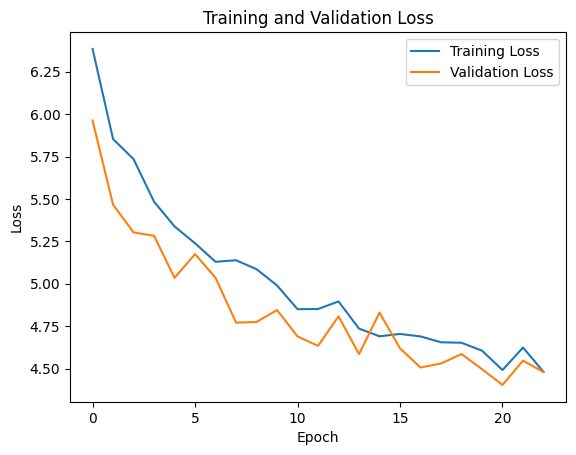

In [ ]:
import matplotlib.pyplot as plt

# Plot the training and validation loss
loss = history.history['loss']
val_loss = history.history['val_loss']
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.title('Training and Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.legend()
plt.show()

In [ ]:
def idx_to_word(integer, tokenizer):
    for word, index in tokenizer.word_index.items():
        if index == integer:
          return word
    return None

In [ ]:
# generate caption for an image
def predict_caption(model, image, tokenizer, max_length):
    # add start tag for generation process
    in_text = 'startseq'
    # iterate over the max length of sequence
    for i in range(max_length):
        # encode input sequence
        sequence = tokenizer.texts_to_sequences([in_text])[0]
        # pad the sequence
        sequence = pad_sequences([sequence], max_length)
        # predict next word
        yhat = model.predict([image, sequence], verbose=0)
        # get index with high probability
        yhat = np.argmax(yhat)
        # convert index to word
        word = idx_to_word(yhat, tokenizer)
        # stop if word not found
        if word is None:
            break
        # append word as input for generating next word
        in_text += " " + word
        # stop if we reach end tag
        if word == 'endseq':
            break
    return in_text

In [ ]:
# Generate captions for test data and evaluate BLEU score
actual, predicted = list(), list()

for key in tqdm(test_data):
    # Get actual caption
    captions = mapping[key]
    # Predict the caption for the image
    y_pred = predict_caption(model, features[key], tokenizer, max_length)
    # Split into words
    actual_captions = [caption.split() for caption in captions]
    y_pred = y_pred.split()
    # Append to the list
    actual.append(actual_captions)
    predicted.append(y_pred)

100%|██████████| 50/50 [02:03<00:00,  2.48s/it]


In [ ]:
import nltk
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
y_pred_tokens = word_tokenize(y_pred)  # Make sure to import word_tokenize from nltk.tokenize
captions_tokens = [word_tokenize(caption) for caption in captions]


TypeError: ignored

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2867937005_91c092b157.jpg
---------------------Actual---------------------
a girl wearing pink does a handstand .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt


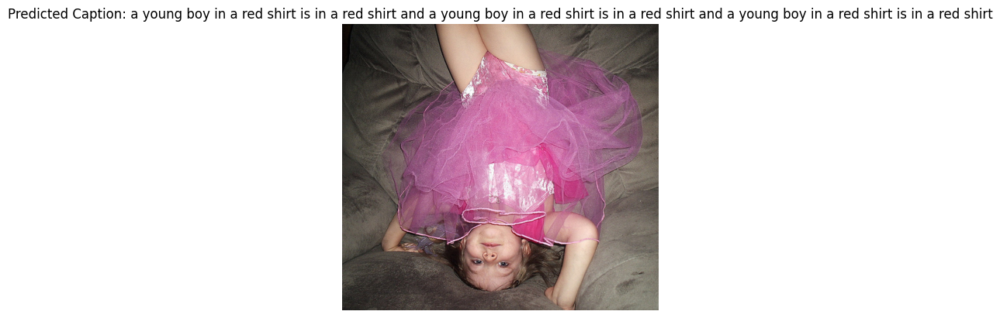

Individual METEOR Score for : 0.0909090909090909
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/226607225_44d696db6b.jpg
---------------------Actual---------------------
The large green fish is jumping out of the water .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


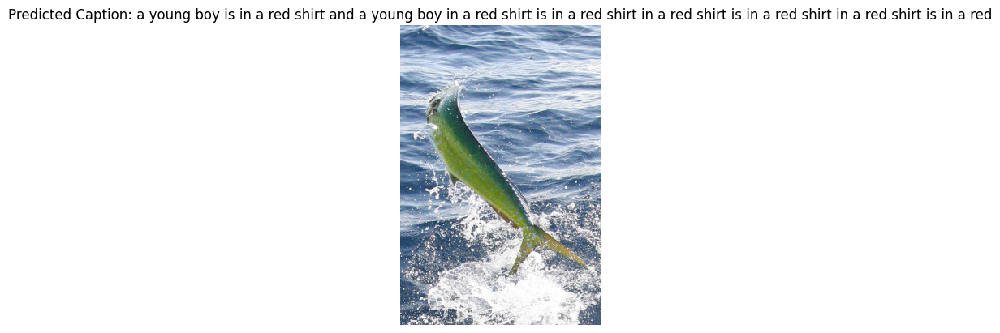

Individual METEOR Score for : 0.0364963503649635
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/481054596_cad8c02103.jpg
---------------------Actual---------------------
two people share a hug .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


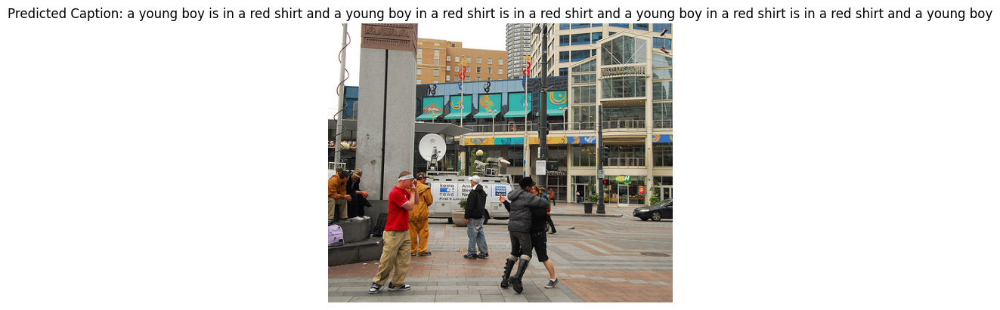

Individual METEOR Score for : 0.05434782608695652
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3044500219_778f9f2b71.jpg
---------------------Actual---------------------
Four women in dresses pose together .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a


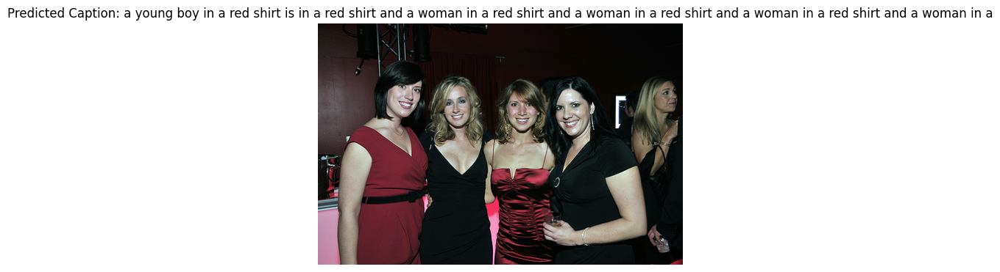

Individual METEOR Score for : 0.04950495049504951
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/508929192_670910fdd2.jpg
---------------------Actual---------------------
Two boys hold badminton rackets to the sky in a backyard .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


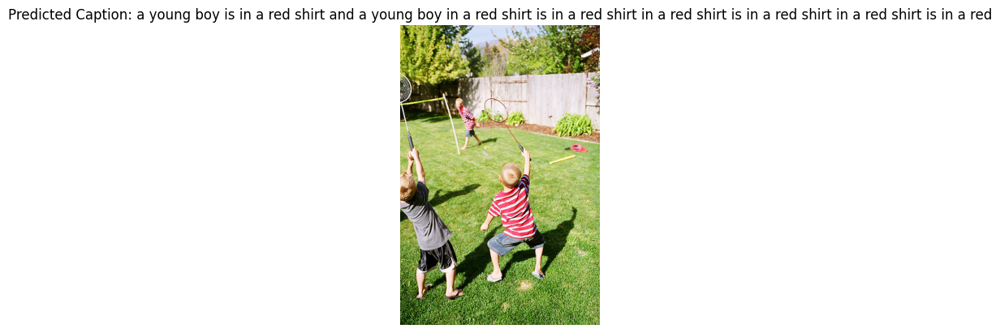

Individual METEOR Score for : 0.17503805175038054
Individual BLEU Score for : 2.8968992041299752e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/284279868_2ca98e3dcd.jpg
---------------------Actual---------------------
Two long haired dogs play in the snow .
--------------------Predicted--------------------
dog in a dog is running in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running


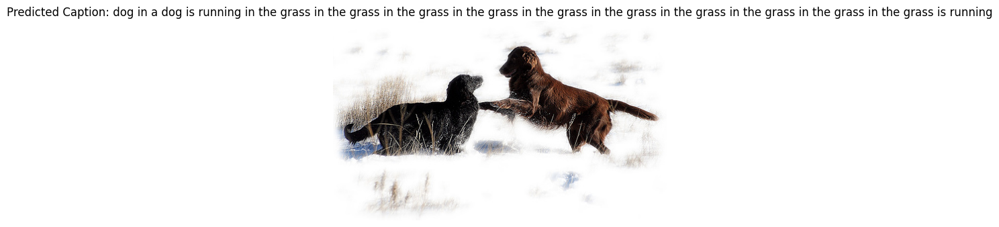

Individual METEOR Score for : 0.2652310924369748
Individual BLEU Score for : 2.8968992041299752e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/1775029934_e1e96038a8.jpg
---------------------Actual---------------------
A wildebeast trips in the field .
--------------------Predicted--------------------
dog is running in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running in the grass in the grass


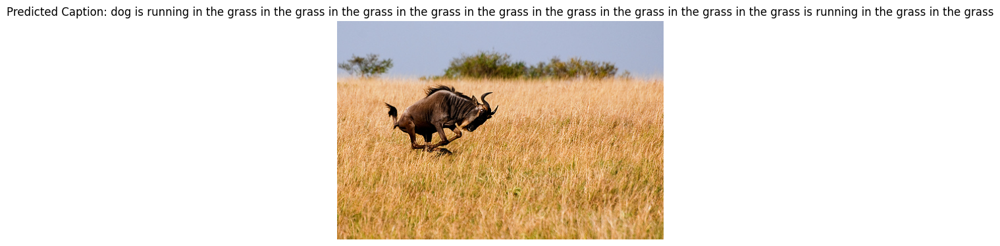

Individual METEOR Score for : 0.18564356435643564
Individual BLEU Score for : 2.8968992041299752e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2358554995_54ed3baa83.jpg
---------------------Actual---------------------
Child getting ready to go down a slide .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


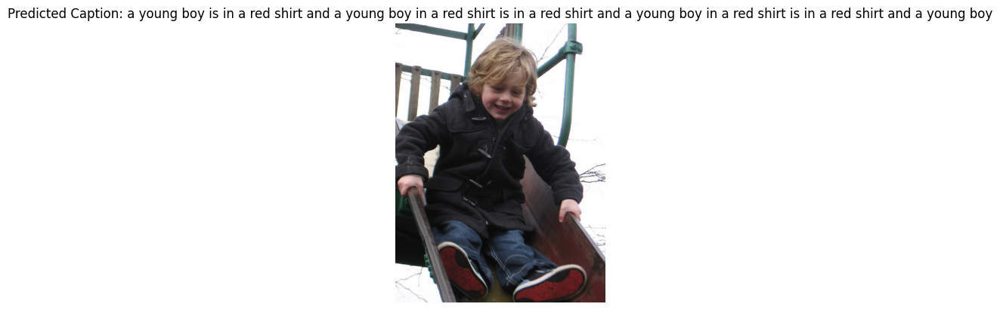

Individual METEOR Score for : 0.04201680672268907
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3262760716_1e9734f5ba.jpg
---------------------Actual---------------------
Baby with his dads glasses in his mouth .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a man in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a


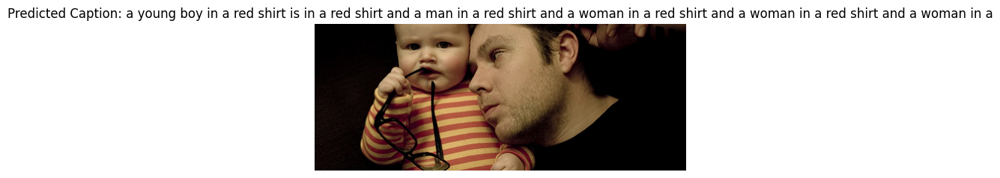

Individual METEOR Score for : 0.04201680672268907
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2450299735_62c095f40e.jpg
---------------------Actual---------------------
Little girl slides down in the pool .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


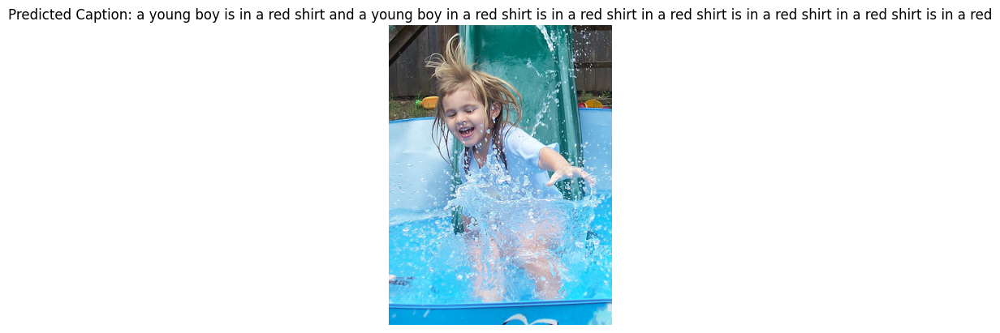

Individual METEOR Score for : 0.04545454545454545
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3449718979_e987c64e2d.jpg
---------------------Actual---------------------
The dog comes down the steps .
--------------------Predicted--------------------
dog in a dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and


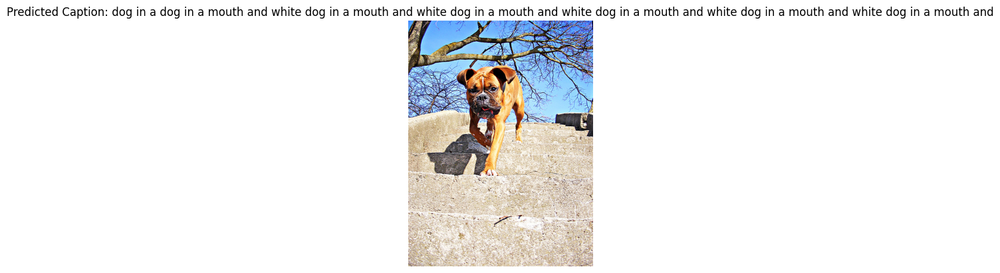

Individual METEOR Score for : 0.04950495049504951
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/436009777_440c7679a1.jpg
---------------------Actual---------------------
Two people talk while sitting on a big rock .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


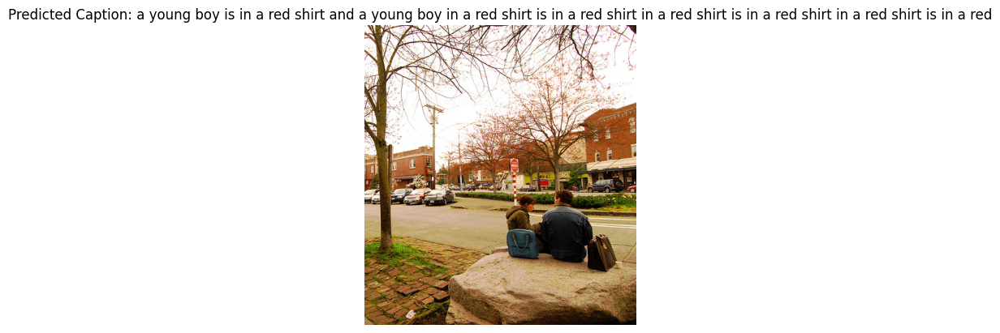

Individual METEOR Score for : 0.0390625
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2618538137_44fffe10c4.jpg
---------------------Actual---------------------
A man wearing no shirt rides a skateboard with a brown dog .
--------------------Predicted--------------------
a young boy is running on a air in the air in the air in the air in the air in the air in the air in the air in the air in the air in the air


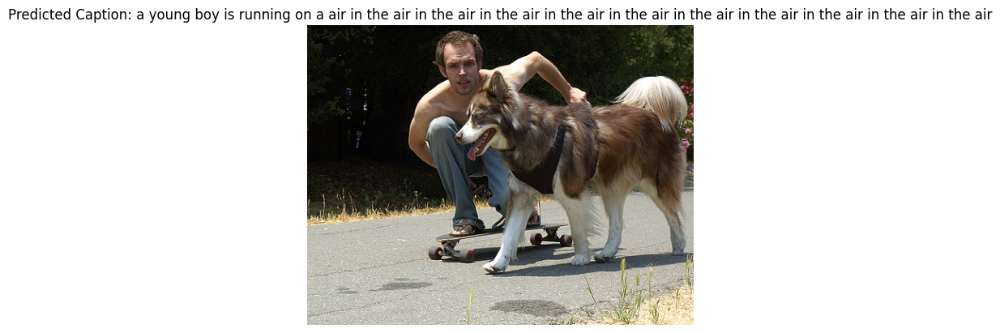

Individual METEOR Score for : 0.06451612903225808
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3186412658_2ab2ebd397.jpg
---------------------Actual---------------------
Woman being lifted by other women play volleyball .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


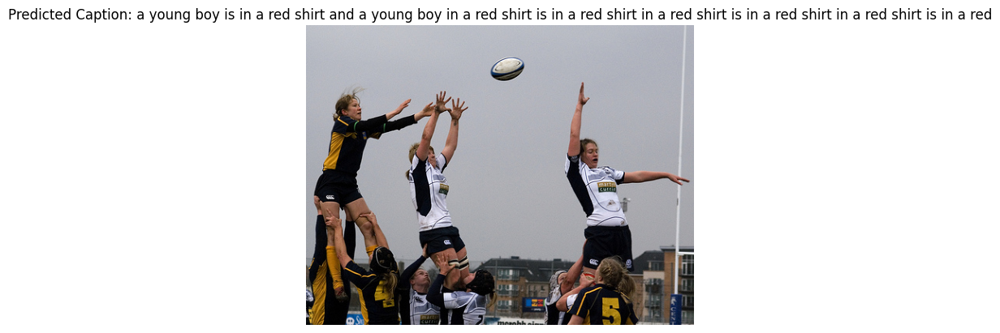

Individual METEOR Score for : 0.04201680672268907
Individual BLEU Score for : 0
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/109823397_e35154645f.jpg
---------------------Actual---------------------
Man on four wheeler in the air .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


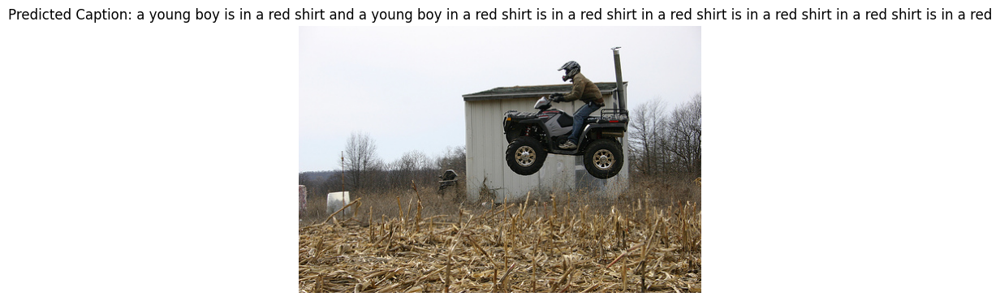

Individual METEOR Score for : 0.04545454545454545
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/344078103_4b23931ce5.jpg
---------------------Actual---------------------
Two dogs run through the snow .
--------------------Predicted--------------------
dog is running in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running in the grass in the grass in the grass


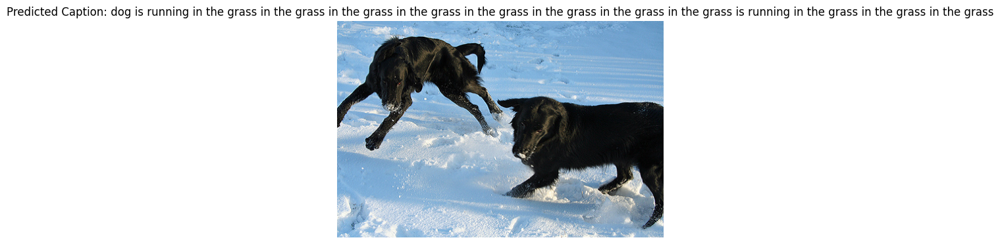

Individual METEOR Score for : 0.14851485148514854
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/263216826_acf868049c.jpg
---------------------Actual---------------------
Two people sitting on a rock overlooking a forest .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


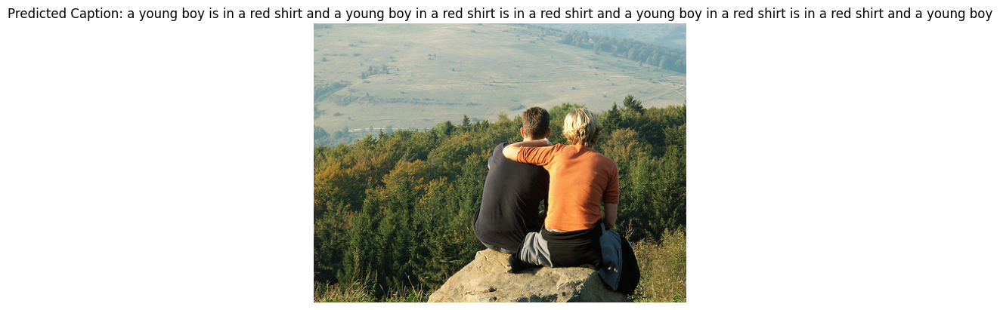

Individual METEOR Score for : 0.078125
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2050067751_22d2763fd2.jpg
---------------------Actual---------------------
The small child in green crocks leans over to look inside a grate .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


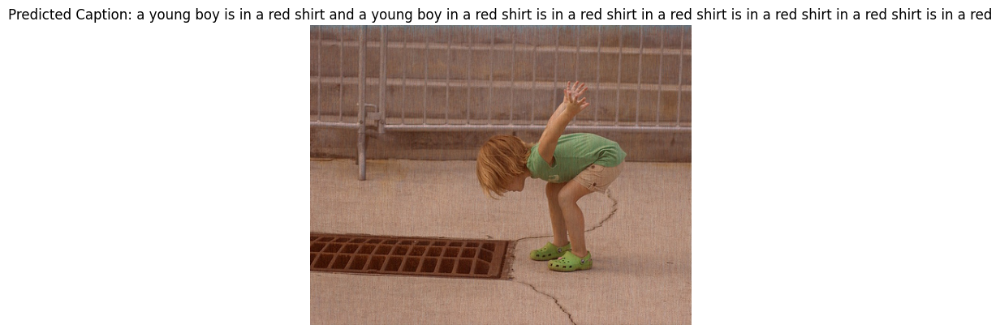

Individual METEOR Score for : 0.06097560975609756
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3583293892_c96af8cd98.jpg
---------------------Actual---------------------
Baseball is being played by two men in red jerseys by a " pepco " sign .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


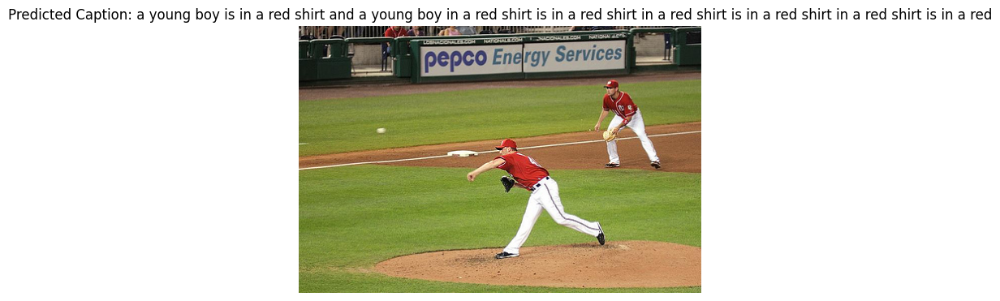

Individual METEOR Score for : 0.13089005235602094
Individual BLEU Score for : 1.0377133938315695e-231
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3530342993_a4a1f0e516.jpg
---------------------Actual---------------------
A stunt cyclist launches himself into midair over a ramp while other cyclists watch .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


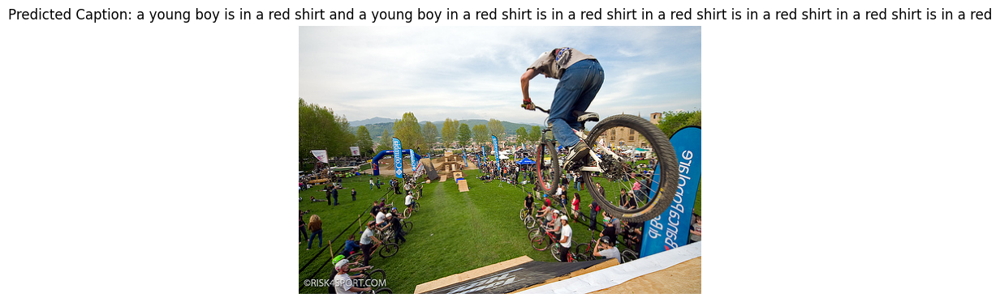

Individual METEOR Score for : 0.057803468208092484
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3709030554_02301229ea.jpg
---------------------Actual---------------------
This boy , wearing a red shirt and blue shorts , is running .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


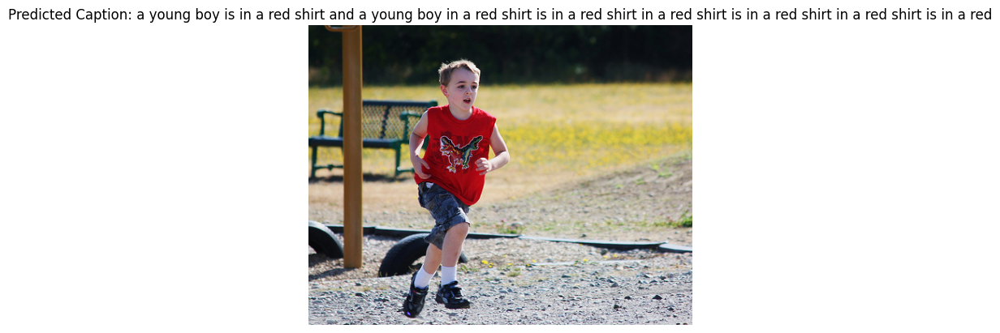

Individual METEOR Score for : 0.2599932249322493
Individual BLEU Score for : 0.06714082273626723
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/1248734482_3038218f3b.jpg
---------------------Actual---------------------
Girl in pink shirt with white writing lying in grass .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt


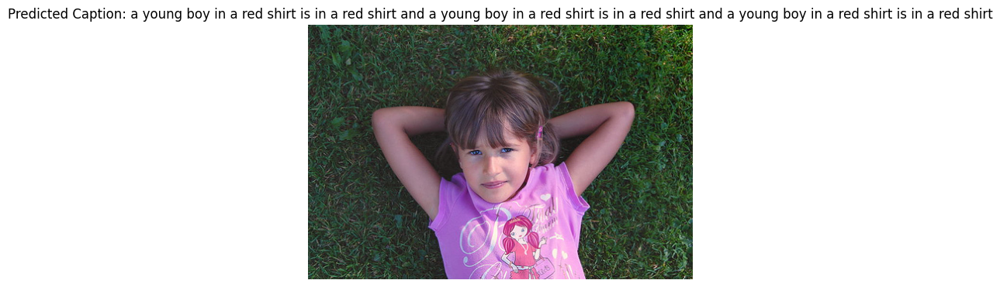

Individual METEOR Score for : 0.1094890510948905
Individual BLEU Score for : 9.65701126654974e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2815755985_0fa55544c0.jpg
---------------------Actual---------------------
A young girl laying on a blue inflatable toy
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a young boy in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in


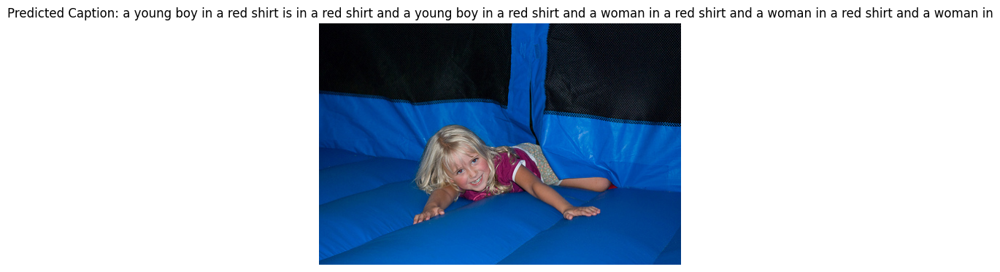

Individual METEOR Score for : 0.12605042016806722
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3655773435_c234e94820.jpg
---------------------Actual---------------------
A small dog swims in a pool .
--------------------Predicted--------------------
dog in a ball in a ball in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running in the grass in the


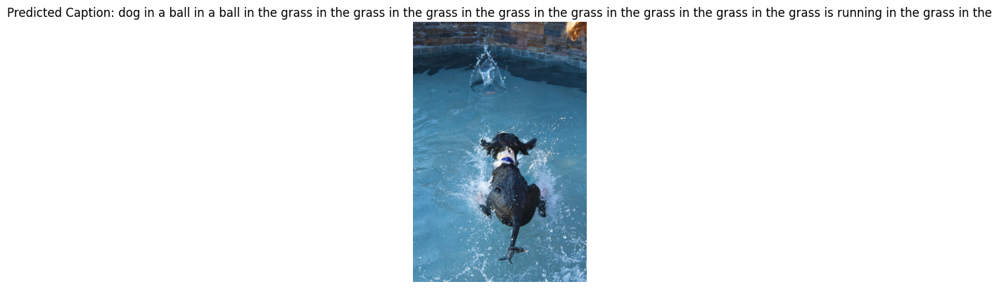

Individual METEOR Score for : 0.1818181818181818
Individual BLEU Score for : 3.2059459724048004e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3245070961_8977fdd548.jpg
---------------------Actual---------------------
A young boy in dark clothing with a smile sprints .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


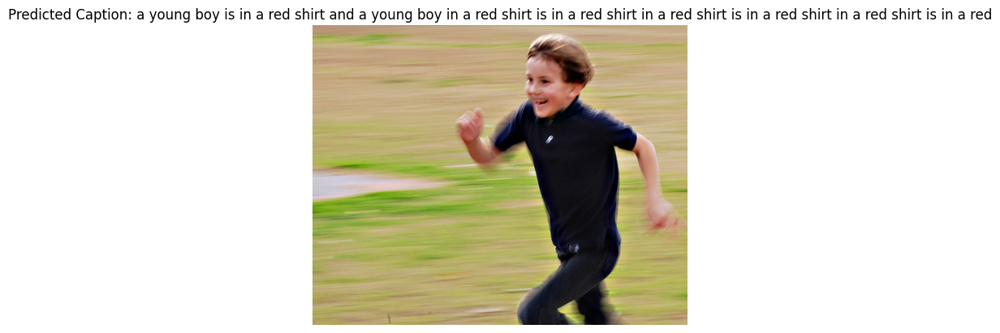

Individual METEOR Score for : 0.2715328467153284
Individual BLEU Score for : 1.3694199461108295e-78
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3335692531_dd4a995f91.jpg
---------------------Actual---------------------
Two black dogs are tugging on a red toy that is in a brown dog 's mouth .
--------------------Predicted--------------------
dog in a ball in a ball in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running in the grass in the


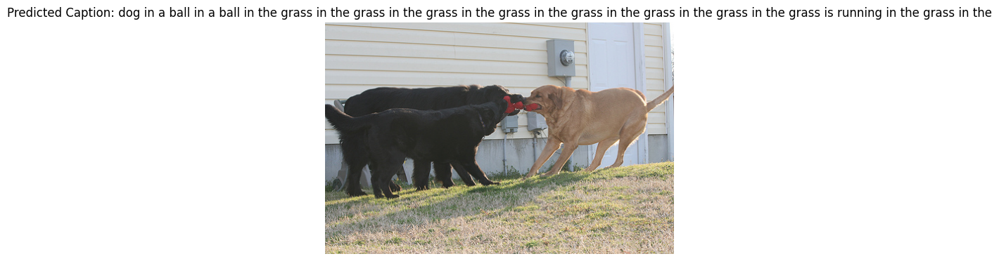

Individual METEOR Score for : 0.125
Individual BLEU Score for : 3.6426579016949087e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3367851138_757d6bd2ef.jpg
---------------------Actual---------------------
The boat is pulled up to dock and a man is pulling something out of the water .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


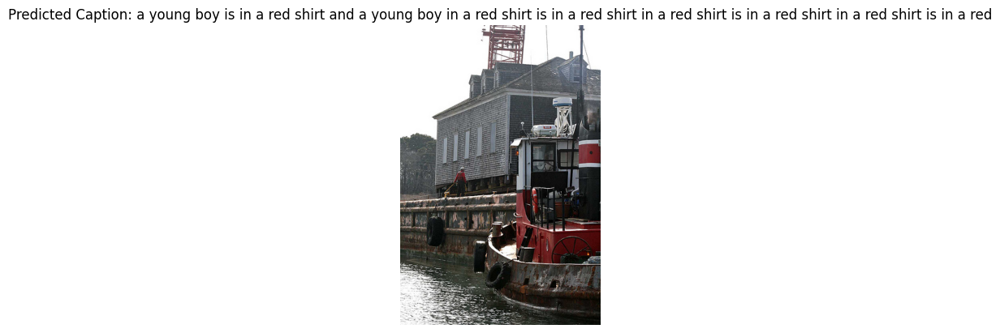

Individual METEOR Score for : 0.1
Individual BLEU Score for : 3.4450131449970394e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3587092143_c63030ed6d.jpg
---------------------Actual---------------------
Two MMA fighters spar in a ring .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a


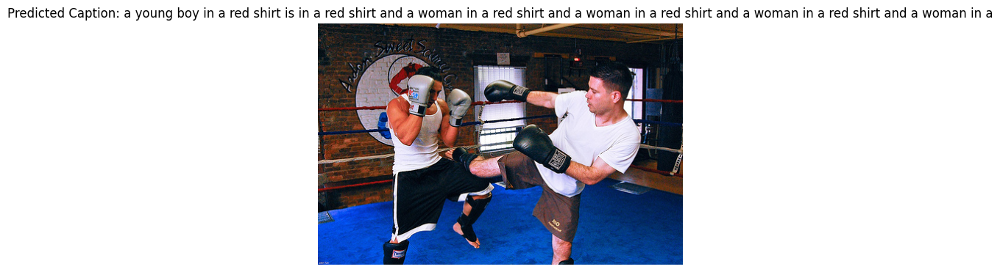

Individual METEOR Score for : 0.17045454545454544
Individual BLEU Score for : 2.8968992041299752e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/1355945307_f9e01a9a05.jpg
---------------------Actual---------------------
The red car has the number seven on the side in a white circle .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


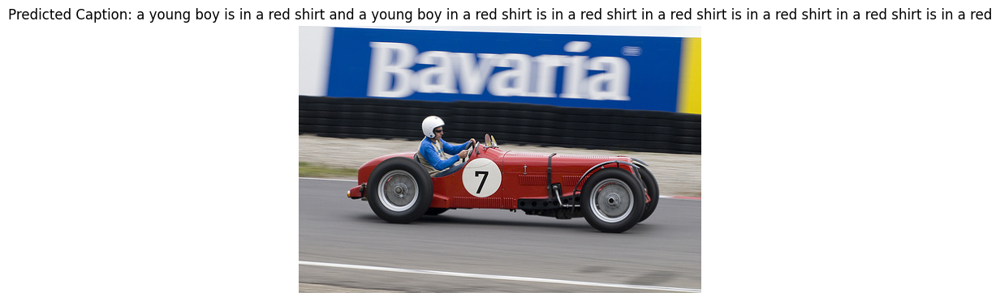

Individual METEOR Score for : 0.1477199743095697
Individual BLEU Score for : 3.2059459724048004e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3185645793_49de805194.jpg
---------------------Actual---------------------
One person jumping his bike towards the camera while another one in the background is walking his bike away from the camera .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


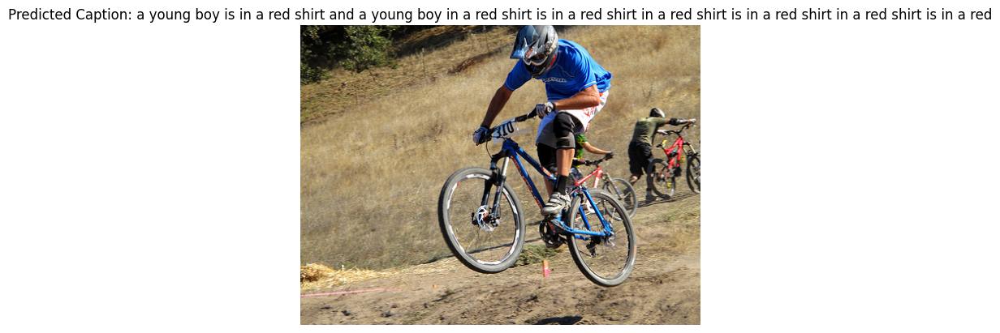

Individual METEOR Score for : 0.04081632653061224
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3530843182_35af2c821c.jpg
---------------------Actual---------------------
A woman in a crochet hat and sunglasses smiles while the man beside her in a plaid short and sunglasses looks behind her .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


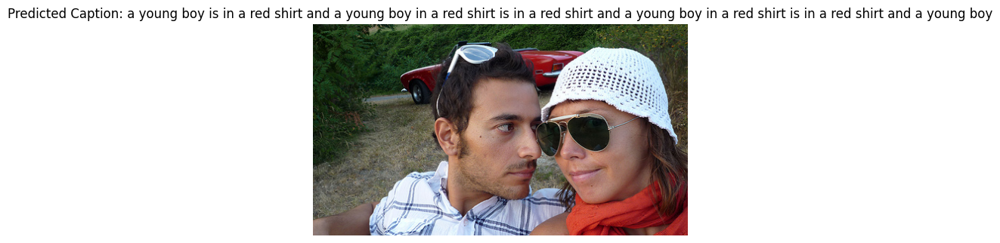

Individual METEOR Score for : 0.1377952755905512
Individual BLEU Score for : 4.533892274410402e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/240696675_7d05193aa0.jpg
---------------------Actual---------------------
The dog is running along a path that has been made through the uncut grass .
--------------------Predicted--------------------
dog in a dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and


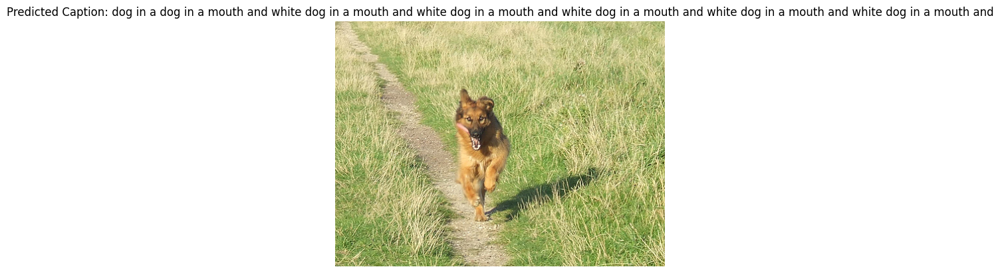

Individual METEOR Score for : 0.054945054945054944
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/287999021_998c2eeb91.jpg
---------------------Actual---------------------
Two smiling climbers with poles sit astride a mountain ridge .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


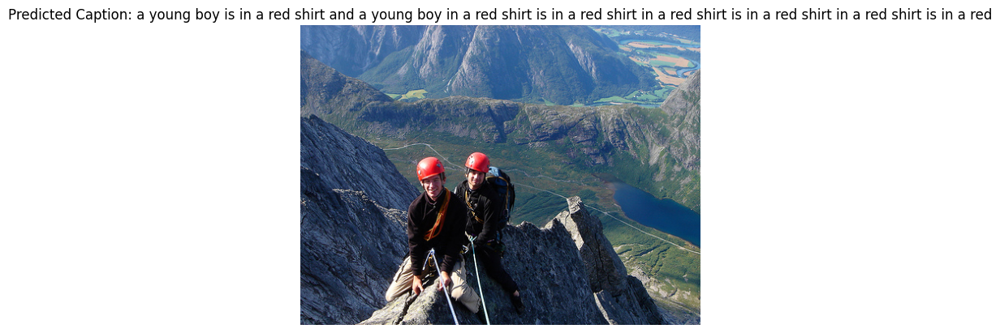

Individual METEOR Score for : 0.0364963503649635
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2710698257_2e4ca8dd44.jpg
---------------------Actual---------------------
Man standing on top of jagged rocks near the ocean .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


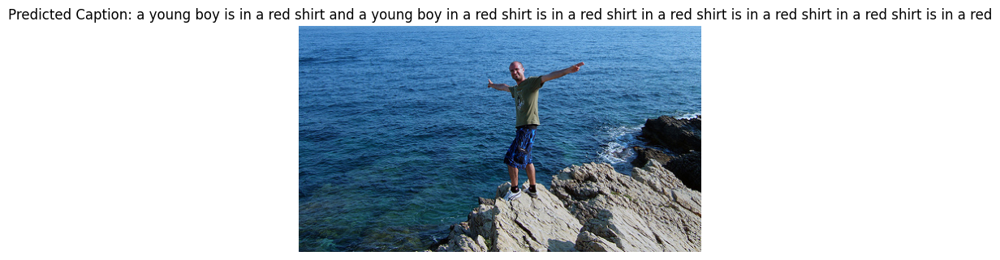

Individual METEOR Score for : 0.0
Individual BLEU Score for : 0
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/143552697_af27e9acf5.jpg
---------------------Actual---------------------
The biker is riding through a grassy plain .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


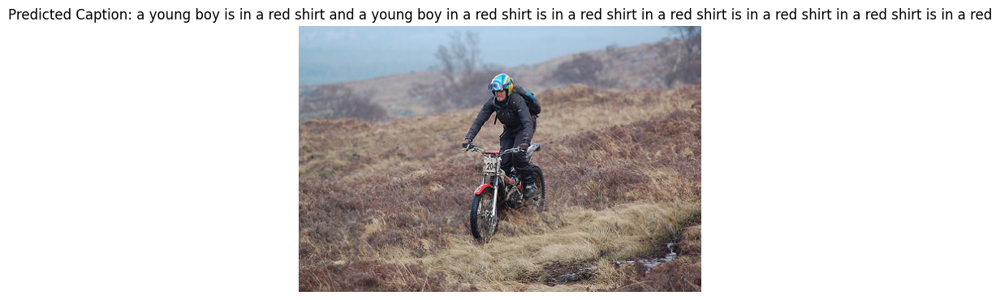

Individual METEOR Score for : 0.08403361344537814
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/431018958_84b2beebff.jpg
---------------------Actual---------------------
The girl is paddling a rusty canoe in the water .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


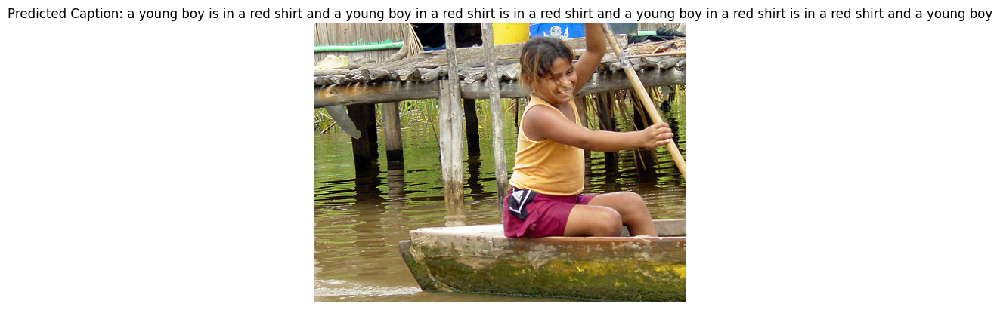

Individual METEOR Score for : 0.1094890510948905
Individual BLEU Score for : 9.65701126654974e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/842960985_91daf0d6ec.jpg
---------------------Actual---------------------
Man walking with his umbrella in a bleak street .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt and a young boy


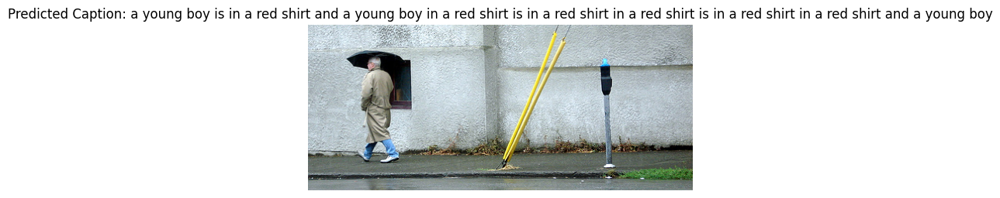

Individual METEOR Score for : 0.078125
Individual BLEU Score for : 2.8968992041299752e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3315110972_1090d11728.jpg
---------------------Actual---------------------
A white heron flies into the sky .
--------------------Predicted--------------------
dog in a red dog is running on a ball in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running in the


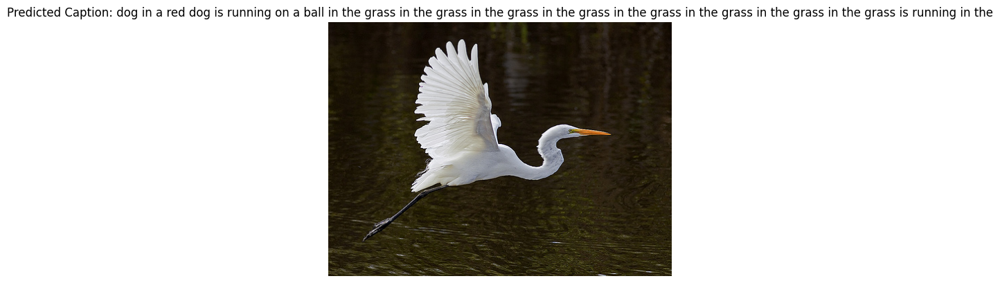

Individual METEOR Score for : 0.0909090909090909
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2043427251_83b746da8e.jpg
---------------------Actual---------------------
Person in blue coat jumping in standing water on pavement with body of water in the background .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


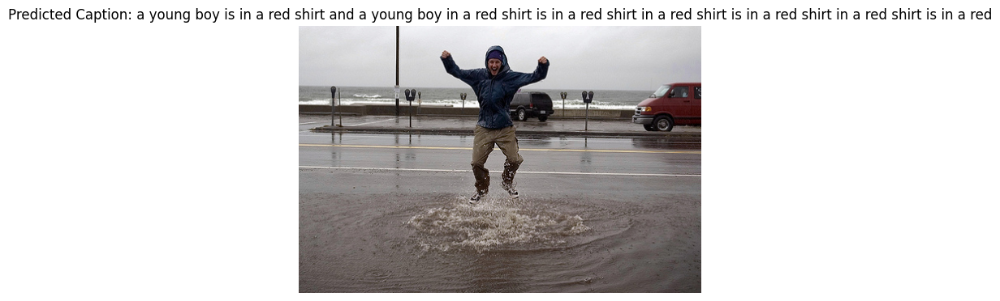

Individual METEOR Score for : 0.075
Individual BLEU Score for : 9.65701126654974e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2922981282_203f04bf9b.jpg
---------------------Actual---------------------
Two young people are lying on a bed together .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a


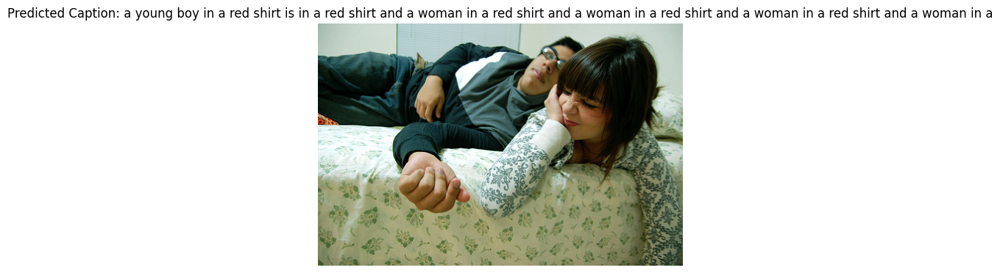

Individual METEOR Score for : 0.078125
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2839932205_3c9c27cd99.jpg
---------------------Actual---------------------
A person is climbing to the top of a rock cliff .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


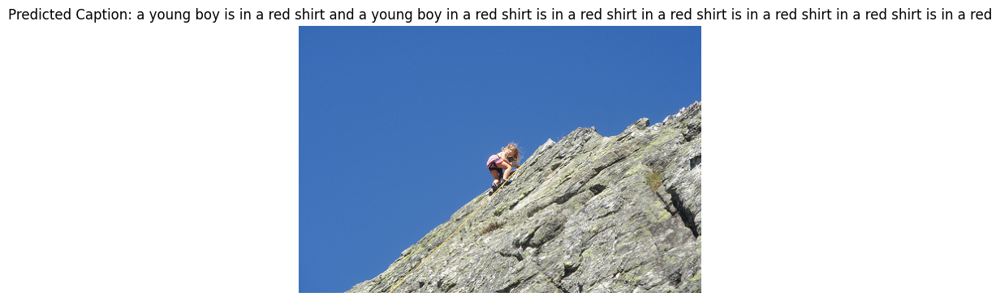

Individual METEOR Score for : 0.10273972602739727
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3544233095_4bca71df1d.jpg
---------------------Actual---------------------
A young boy carries a green bucket on a sandy beach with a cloudy sky overhead .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


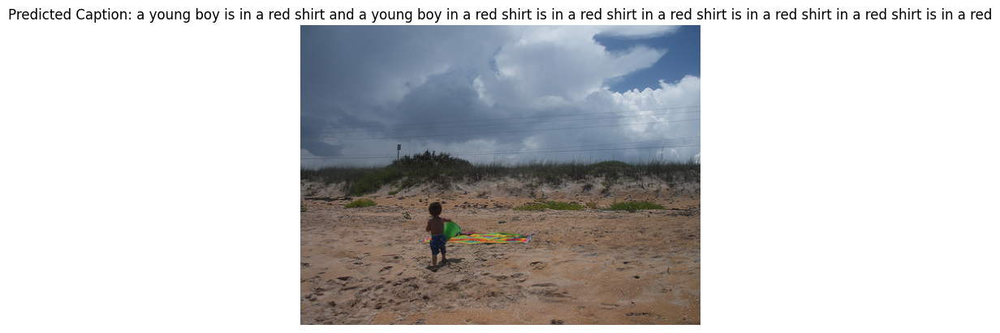

Individual METEOR Score for : 0.22324025596276906
Individual BLEU Score for : 3.6426579016949087e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3585495069_33cba06d0a.jpg
---------------------Actual---------------------
Four school aged kids are playing dodgeball in the gym
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


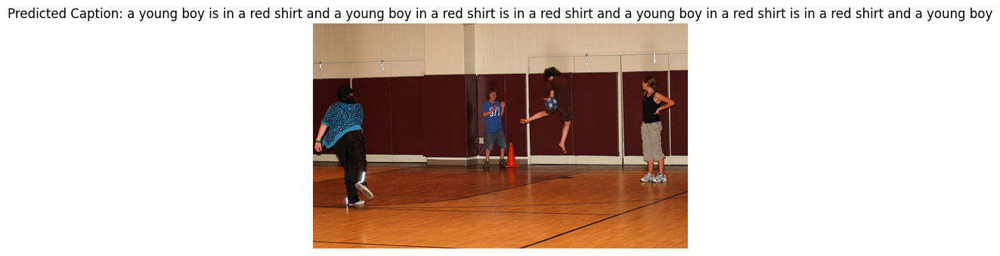

Individual METEOR Score for : 0.0390625
Individual BLEU Score for : 7.337741777064293e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3601508034_5a3bfc905e.jpg
---------------------Actual---------------------
Two men playing field hockey
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


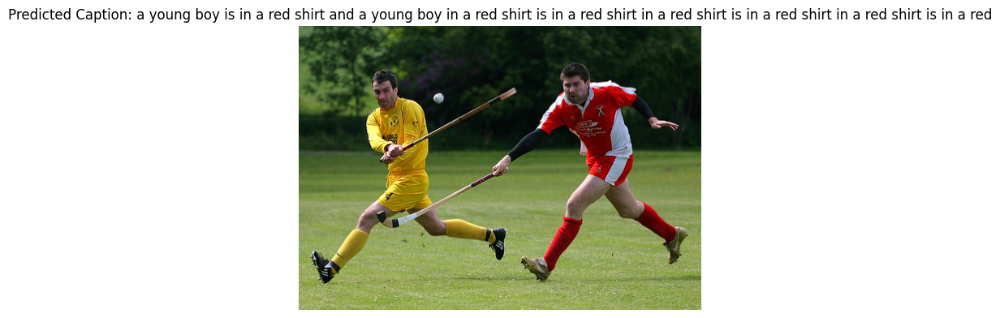

Individual METEOR Score for : 0.0
Individual BLEU Score for : 0
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3030824089_e5a840265e.jpg
---------------------Actual---------------------
A German shepherd jumps left on patchy grass .
--------------------Predicted--------------------
dog in a dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and white dog in a mouth and


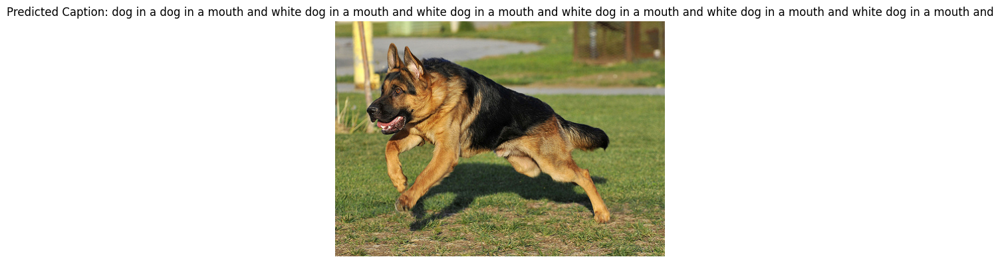

Individual METEOR Score for : 0.04201680672268907
Individual BLEU Score for : 0
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3085667767_66041b202e.jpg
---------------------Actual---------------------
The surfer does a flip off of a wave .
--------------------Predicted--------------------
a young boy is running on a air in the air in the air in the air in the air in the air in the air in the air in the air in the air in the air


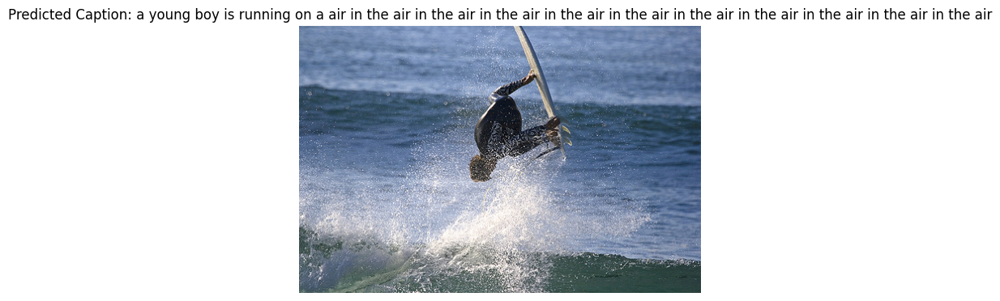

Individual METEOR Score for : 0.11718749999999999
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2848571082_26454cb981.jpg
---------------------Actual---------------------
The black and brown dog jumps in the air to catch the ball .
--------------------Predicted--------------------
a dog is running on a ball in the grass in the grass in the grass in the grass in the grass in the grass in the grass in the grass is running on a ball in the


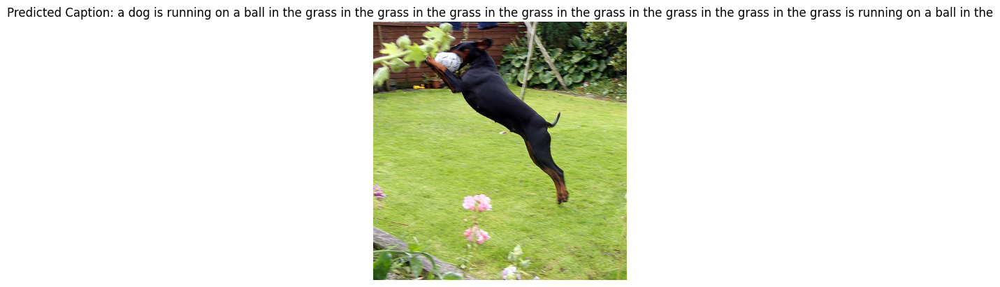

Individual METEOR Score for : 0.18292682926829268
Individual BLEU Score for : 3.6426579016949087e-155
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/1286408831_05282582ed.jpg
---------------------Actual---------------------
The boy is climbing .
--------------------Predicted--------------------
a young boy in a red shirt is in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a red shirt and a woman in a


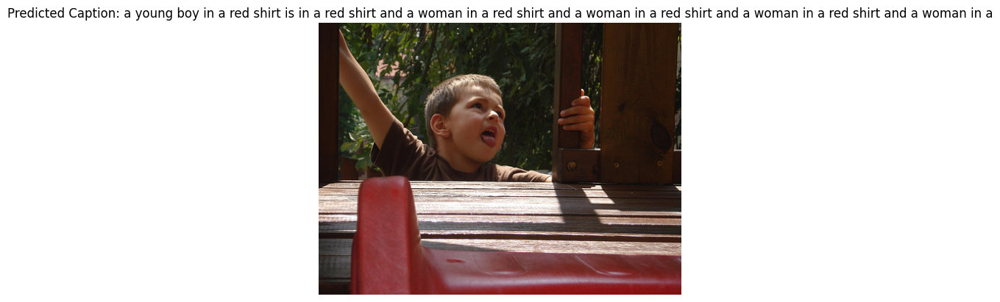

Individual METEOR Score for : 0.12048192771084339
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/2557972410_6925fe695c.jpg
---------------------Actual---------------------
Two children play street hockey in front of a goal .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt in a red shirt is in a red shirt in a red shirt is in a red


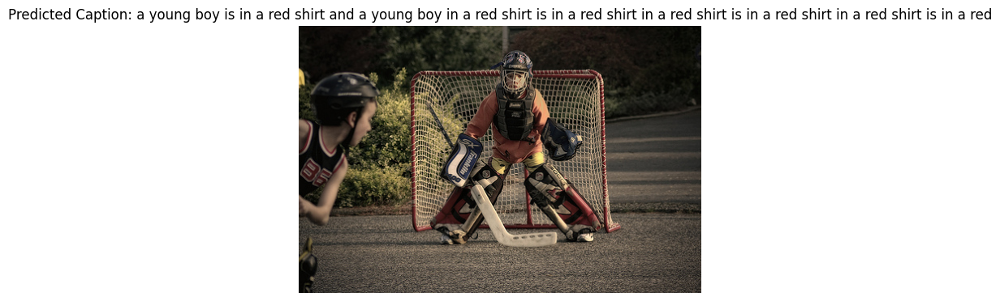

Individual METEOR Score for : 0.072992700729927
Individual BLEU Score for : 8.726094729337945e-232
/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset/3470303255_fbb41b8dd0.jpg
---------------------Actual---------------------
The young child looked up toward the white flowers .
--------------------Predicted--------------------
a young boy is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy in a red shirt is in a red shirt and a young boy


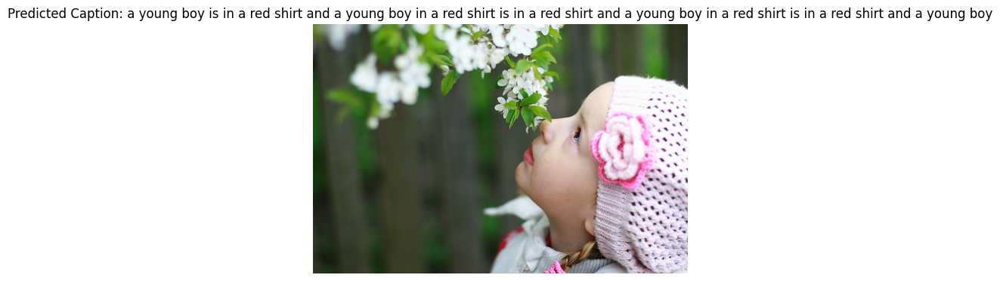

Individual METEOR Score for : 0.0390625
Individual BLEU Score for : 7.337741777064293e-232
Overall METEOR Score: 0.09842053505209936
Overall BLEU Score: 0.0013428164547253445


In [ ]:
from nltk.translate.bleu_score import sentence_bleu

# Assuming you have already defined the functions and variables: predict_caption, features, mapping, tokenizer, max_length, test_data, and model

# Download the 'punkt' tokenizer data
nltk.download('punkt')

meteor_scores = []  # To store individual METEOR scores for each image caption
bleu_scores = []    # To store individual BLEU scores for each image caption

# Iterate over the test images and generate captions
for image_name in test_data:
    image_id = image_name.split('.')[0]
    img_path = os.path.join('/content/drive/MyDrive/CNN_LSTM/Flicker8k_Dataset', image_name)
    img_path = img_path + '.jpg'
    print(img_path)

    # Get the actual captions
    captions = mapping[image_id]

    # Remove 'startseq' and 'endseq' tokens from the actual captions
    captions = [caption.replace('startseq', '').replace('endseq', '').strip() for caption in captions]

    print('---------------------Actual---------------------')
    for caption in captions:
        print(caption)

    # Predict the caption
    y_pred = predict_caption(model, features[image_id], tokenizer, max_length)

    # Remove 'startseq' and 'endseq' tokens from the predicted caption
    y_pred = y_pred.replace('startseq', '').replace('endseq', '').strip()

    print('--------------------Predicted--------------------')
    print(y_pred)

    # Display the image
    img = Image.open(img_path)
    plt.imshow(img)
    plt.title("Predicted Caption: " + y_pred)
    plt.axis('off')
    plt.show()

    # Tokenize the predicted caption
    y_pred_tokens = word_tokenize(y_pred)

    # Tokenize the actual captions (if they are not already tokenized)
    captions_tokens = [word_tokenize(caption) for caption in captions]

    # Calculate METEOR score for each predicted caption
    meteor_score_value = meteor_score(captions_tokens, y_pred_tokens)
    meteor_scores.append(meteor_score_value)

    # Calculate BLEU score for each predicted caption
    bleu_score_value = sentence_bleu(captions_tokens, y_pred_tokens)
    bleu_scores.append(bleu_score_value)

    # Print individual METEOR and BLEU scores for each image
    print('Individual METEOR Score for :', meteor_score_value)
    print('Individual BLEU Score for :', bleu_score_value)

# Calculate overall METEOR score
overall_meteor_score = sum(meteor_scores) / len(meteor_scores)

# Calculate overall BLEU score
overall_bleu_score = sum(bleu_scores) / len(bleu_scores)

# Print overall METEOR and BLEU scores
print('Overall METEOR Score:', overall_meteor_score)
print('Overall BLEU Score:', overall_bleu_score)
